# Coronavirus Tweets: Sentiment Analysis

**Objective:** classify the tweets about Corona Virus as 5 classes: `'Extremely Negative', 'Extremely Positive', 'Negative', 'Neutral', 'Positive'`
The steps to achieve this task are the next:
1. Exploratory Data Analsis (EDA)
2. Clean Textual Data
4. Vectorize Texts 
5. Classification model
6. Evaluation
8. Evaluate on Test set
9. Use Lime to explain one text classification (from the test set)


# 1. Exploratory Data Analysis

In [157]:
import pandas as pd, seaborn as sns
import numpy as np

In [158]:
train_df = pd.read_csv(r'path\file_tweets.csv', encoding='latin')

In [160]:
train_df = train_df[['OriginalTweet', 'Sentiment']]

In [162]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41157 entries, 0 to 41156
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   OriginalTweet  41157 non-null  object
 1   Sentiment      41157 non-null  object
dtypes: object(2)
memory usage: 643.2+ KB


<Axes: xlabel='Sentiment', ylabel='count'>

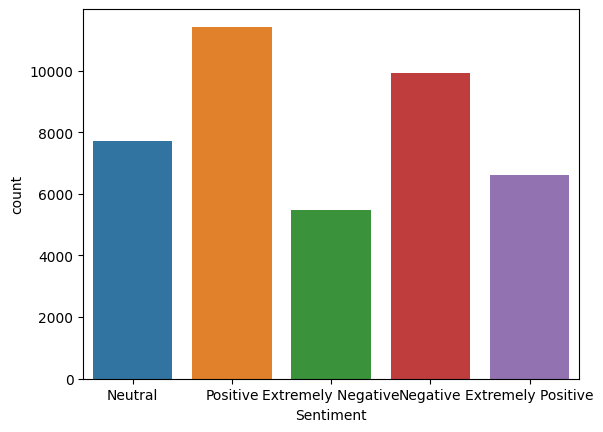

In [163]:
#| label: code-2
#| fig-cap: "Distribution of the Sentiment classes"
sns.countplot(x=train_df.Sentiment)

In [164]:
set(train_df.Sentiment)

{'Extremely Negative', 'Extremely Positive', 'Negative', 'Neutral', 'Positive'}

check the number of rows per each category:

In [165]:
#| label: code-3
#| fig-cap: "Table of Classes"
train_df.groupby('Sentiment').count()

,OriginalTweet
Sentiment,
Extremely Negative,5481
Extremely Positive,6624
Negative,9917
Neutral,7713
Positive,11422


Also it will be checked if there is any duplicate data in the dataset:


In [166]:
grouped = train_df.groupby("Sentiment")
unique_values_per_sentiment = grouped["OriginalTweet"].nunique()
unique_values_per_sentiment

Sentiment
Extremely Negative     5481
Extremely Positive     6624
Negative               9917
Neutral                7713
Positive              11422
Name: OriginalTweet, dtype: int64

The data has some umbalanced categories. *Extremely Negative* has only the half of cases as *Positive*

Also, in the example of the data, it can be seen that there are a lot of non alphanumerical characters as @, ?. Also that the texts are in mayusc and minus. Issues that are going to be handled in the cleaning. However, it is not detected any html format in the text which would also need a treatment in case of any.



In [167]:
#| label: code-1
train_df.head(10)

,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,advice Talk to your neighbours family to excha...,Positive
2,Coronavirus Australia: Woolworths to give elde...,Positive
3,My food stock is not the only one which is emp...,Positive
4,"Me, ready to go at supermarket during the #COV...",Extremely Negative
5,As news of the regionÂs first confirmed COVID...,Positive
6,Cashier at grocery store was sharing his insig...,Positive
7,Was at the supermarket today. Didn't buy toile...,Neutral
8,Due to COVID-19 our retail store and classroom...,Positive
9,"For corona prevention,we should stop to buy th...",Negative


In [168]:
train_df.OriginalTweet.head(4)

0    @MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...
1    advice Talk to your neighbours family to excha...
2    Coronavirus Australia: Woolworths to give elde...
3    My food stock is not the only one which is emp...
Name: OriginalTweet, dtype: object

Also, it is going to be checked any nulls in the data

Check also the lenght of the tweets

In [172]:
num_char = train_df['OriginalTweet'].apply(len)
num_char

0        111
1        237
2        131
3        306
4        310
        ... 
41152    102
41153    138
41154    136
41155    111
41156    255
Name: OriginalTweet, Length: 41157, dtype: int64

In [173]:
num_char.mean()

204.20016036154237

In [174]:
model_df = train_df.copy()
model_df.head()

,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,advice Talk to your neighbours family to excha...,Positive
2,Coronavirus Australia: Woolworths to give elde...,Positive
3,My food stock is not the only one which is emp...,Positive
4,"Me, ready to go at supermarket during the #COV...",Extremely Negative


In [175]:
def count_words(text):
    words = text.split()
    return len(words)

lenword = model_df['OriginalTweet'].apply(count_words)
lenword.mean()

30.5003037150424

Finally checking the average of words per tweet. Which in average it is being written 30 words per tweet.

## Treat the umbalanced data with data augmentation

With the help of the next articles
https://towardsdatascience.com/how-i-handled-imbalanced-text-data-ba9b757ab1d8

 https://github.com/kothiyayogesh/medium-article-code/blob/master/How%20I%20dealt%20with%20Imbalanced%20text%20dataset/data_augmentation_using_language_translation.ipynb.
 I will try to balance the data by traslating the tweets from english to another language and then back to the english.

In this case the unbalanced classes are:
+ Neutral
+ Extremely negative
+ Extremely positive

For each of this classes it will be translated 2000 texts and try to balance the data


In [176]:
#!pip install translate

In [177]:
#ip install deep-translator

In [178]:
'''
#Google Translator
from translate import Translator
from deep_translator import MyMemoryTranslator
import random

def translation_balance(texto):
    sr = random.SystemRandom()
    languages = ["es", "fr", "nl"]

    dest_lang = sr.choice(languages)
    try:
        # Translate to a random language
        translator1 = Translator( to_lang=dest_lang)
        text_translated = translator1.translate(texto)
        #print("Translated to random language:", text_translated)

        # Format the translated text
        formatted_text = text_translated.upper()

        # Translate the formatted text back to English
        translator2 = Translator(from_lang=dest_lang, to_lang="en")
        text_translated_back = translator2.translate(formatted_text)
        #print("Translated back to English:", text_translated_back)

        return text_translated_back
    except Exception as e:
        #print(f"Translation failed: {e}")
        return None
'''

'\n#Google Translator\nfrom translate import Translator\nfrom deep_translator import MyMemoryTranslator\nimport random\n\ndef translation_balance(texto):\n    sr = random.SystemRandom()\n    languages = ["es", "fr", "nl"]\n\n    dest_lang = sr.choice(languages)\n    try:\n        # Translate to a random language\n        translator1 = Translator( to_lang=dest_lang)\n        text_translated = translator1.translate(texto)\n        #print("Translated to random language:", text_translated)\n\n        # Format the translated text\n        formatted_text = text_translated.upper()\n\n        # Translate the formatted text back to English\n        translator2 = Translator(from_lang=dest_lang, to_lang="en")\n        text_translated_back = translator2.translate(formatted_text)\n        #print("Translated back to English:", text_translated_back)\n\n        return text_translated_back\n    except Exception as e:\n        #print(f"Translation failed: {e}")\n        return None\n'

In [179]:
'''texto_input = 'This is a task'

# Call the function with the input text
translated_text = translation_balance(texto_input)

# Print the results
print("Translated text:", translated_text)'''


'texto_input = \'This is a task\'\n\n# Call the function with the input text\ntranslated_text = translation_balance(texto_input)\n\n# Print the results\nprint("Translated text:", translated_text)'

testing on the function:

In [180]:
'''subset_neutral = model_df[model_df['Sentiment'] == 'Neutral'].sample(n=1000, replace=False)
subset_negative = model_df[model_df['Sentiment'] == 'Extremely Negative'].sample(n=2000, replace=False)
subset_positive = model_df[model_df['Sentiment'] == 'Extremely Positive'].sample(n=1500, replace=False)
subset_neutral'''

"subset_neutral = model_df[model_df['Sentiment'] == 'Neutral'].sample(n=1000, replace=False)\nsubset_negative = model_df[model_df['Sentiment'] == 'Extremely Negative'].sample(n=2000, replace=False)\nsubset_positive = model_df[model_df['Sentiment'] == 'Extremely Positive'].sample(n=1500, replace=False)\nsubset_neutral"

In [181]:
'''subset_neutral['OriginalTweet'] = subset_neutral['OriginalTweet'].apply(lambda x: translation_balance(x))
subset_negative['OriginalTweet'] = subset_negative['OriginalTweet'].apply(lambda x: translation_balance(x))
subset_positive['OriginalTweet'] = subset_positive['OriginalTweet'].apply(lambda x: translation_balance(x))'''

"subset_neutral['OriginalTweet'] = subset_neutral['OriginalTweet'].apply(lambda x: translation_balance(x))\nsubset_negative['OriginalTweet'] = subset_negative['OriginalTweet'].apply(lambda x: translation_balance(x))\nsubset_positive['OriginalTweet'] = subset_positive['OriginalTweet'].apply(lambda x: translation_balance(x))"

Since the provided translation services come with a limit on the free coverage. It is being used a excel drive to create the data augmentation and it was replicated the logic applied in the lines of code in this part. The final data augmentation documentation is going to be merged with the root data.
https://docs.google.com/spreadsheets/d/1_csmkpuRPTeMOAeUrfycXh5i6IZjv6MMNBtVU1efBFc/edit?usp=sharing 

In [182]:
aug_df = pd.read_csv(r'path\Translations Data Augmentation - To export.csv', encoding='latin')
aug_df.head()

,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,I was at the supermarket today. I didn't buy t...,Neutral
2,Throughout the month there have been no crowds...,Neutral
3,????? ????? ????? ????? ??\n ?????? ????? ????...,Neutral
4,@eyeonthearctic 16MAR20 Russia's consumer watc...,Neutral


In [183]:
model_df_1 = pd.concat([model_df, aug_df], axis=0, ignore_index=True)
len(model_df_1)

48140

In [184]:
model_df_1.head()

,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,advice Talk to your neighbours family to excha...,Positive
2,Coronavirus Australia: Woolworths to give elde...,Positive
3,My food stock is not the only one which is emp...,Positive
4,"Me, ready to go at supermarket during the #COV...",Extremely Negative


In [185]:
model_df_1 = model_df_1.drop_duplicates()

In [186]:
model_df_1.head()

,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,advice Talk to your neighbours family to excha...,Positive
2,Coronavirus Australia: Woolworths to give elde...,Positive
3,My food stock is not the only one which is emp...,Positive
4,"Me, ready to go at supermarket during the #COV...",Extremely Negative


<Axes: xlabel='Sentiment', ylabel='count'>

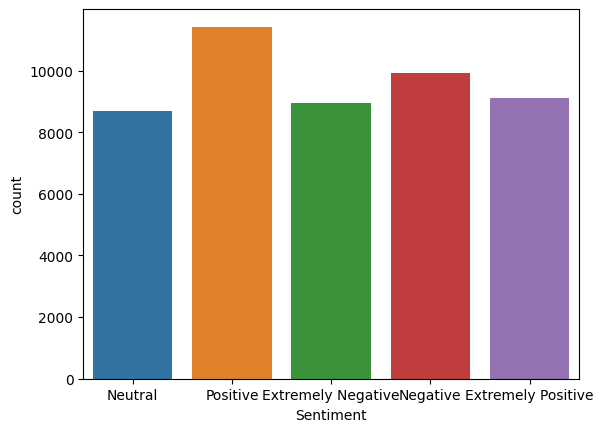

In [187]:
#| label: code-4
#| fig-cap: "New distribution of classes"
sns.countplot(x=model_df_1.Sentiment)

Still the data is not balanced enough but it can be checked that the *extremely negative* class is not longer the half of the prominent class *Positive*

In [188]:
#| label: code-5
model_df_1.groupby('Sentiment').count()

,OriginalTweet
Sentiment,
Extremely Negative,8945
Extremely Positive,9118
Negative,9917
Neutral,8678
Positive,11422


After building data augmentation, the new datasets are append with the current main dataset

Put the **Y** as a label.


In [189]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
model_df_1['Sentiment'] = le.fit_transform(model_df_1['Sentiment'])
model_df_1.head()

,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,3
1,advice Talk to your neighbours family to excha...,4
2,Coronavirus Australia: Woolworths to give elde...,4
3,My food stock is not the only one which is emp...,4
4,"Me, ready to go at supermarket during the #COV...",0


How to manage umbalanced data

# 2. Splitting the data into training a test

In [190]:
X = model_df_1['OriginalTweet']
Y = model_df_1['Sentiment']


In [191]:
Y

0        3
1        4
2        4
3        4
4        0
        ..
48135    1
48136    1
48137    1
48138    1
48139    1
Name: Sentiment, Length: 48080, dtype: int32

In [192]:
from posixpath import split
# we will stratify so the distribution of the classes be equal in all the cases

from sklearn.model_selection import train_test_split

X_train, X_test, Y_train, Y_test = train_test_split(X,Y, random_state=23,test_size=0.25, stratify=Y)

In [193]:
#| label: code-6
print(X_train.shape, Y_train.shape)
print(X_test.shape, Y_test.shape)

(36060,) (36060,)
(12020,) (12020,)


In [194]:
X_train

655      Im fucking calling it now, covid-19 isnt gonna...
14088    @Imagecaptured @JamesCanby Agreed I can tell y...
36393    @Viziblapp hosted a webinar with three procure...
337      In the wake of COVID-19, we are working with a...
9571     Hello Are you a complete fucking moron Then th...
                               ...                        
7399     Due to the outbreak of COVID-19 Washington sta...
39963    Just came back from the supermarket ?I had nev...
2256     Went to the grocery store (more cookies were b...
4982     Hearing that Indians in #USA and other nations...
28491    Just a reminder folks, your local Walgreens an...
Name: OriginalTweet, Length: 36060, dtype: object

# 3. Clean Textual Data


In the previous exploratory block it was shown that the texts possess a lot of:
+ non-alphanumerical characters as #,@ use to tag and do hashtags
+ links of webpages
+ puntuation signs
 In this step these issues are going to be solved.

 *To mention that in this dataset there is no emojis but would be of help to understand the sentiments as well*

 *Also is not use the NTLK STOP LIBRARY  since it has in the storage negative connectors which are of relevance for the negative tweets*

In [195]:
import re #manipulation of the text by REGeX methodology
from bs4 import BeautifulSoup #library to manipulate HTML code. which in this case there are present web links.
import sklearn.feature_extraction._stop_words as stop_words


In [196]:
# this dictionary is created in order correct some contractions that can happen in common language in the tweets
Apostrophes_expansion = {
    "'s": " is",
    "'re": " are",
    "'r": " are",
    "'ll": " will",
    "'d": " would",
    "won't": "will not",
    "can't": "cannot",
    "couldn't": "could not",
    "shouldn't": "should not",
    " isn't ": " is not",
    "don't": "do not"
}

In [197]:
#!pip install pyspellchecker

In [242]:
def strip(text):
   #from textblob import TextBlob
   from nltk.stem import WordNetLemmatizer
   #from spellchecker import SpellChecker
   text = text.lower()
   #remove HTML tags, there is no cases in the current dataset but could happen in a tweet
   tweet = BeautifulSoup(text).get_text()
   #remove URlS
   tweet = ' '.join(re.sub("(\w+:\/\/\S+)", " ", tweet).split())
   #remove the gramatical contractions in English
   tweet = ' '.join([Apostrophes_expansion[word] if word in Apostrophes_expansion else word for word in tweet.split()])
   
   #remove the mention character since does not give particular information on the sentiment. However it will be keeped the texts of hashtags
   tweet = ' '.join(re.sub("(@[A-Za-z0-9]+)"," ", tweet).split())
   
   #remove the hashtags related to covid (kind of stopwords in this specific case)
   #tweet = ' '.join(re.sub(r"#(covid\w*|coronavirus\w*)", "", tweet).split())
 
   #Remove all the punctation signs that are not alphanumerical
   tweet = ' '.join(re.sub("[^a-zA-Z0-9\s]"," ", tweet).split())
   
   #removing cases in which the word has several repeated characters
   tweet = ' '.join(re.sub(r"(.)\1+", r"\1\1", tweet).split())
   
   
   #Lemmatization: Using the grammatical roots to understand and modify the words to the origin
   lemmatizer = WordNetLemmatizer()
   tweeter =  ' '.join([lemmatizer.lemmatize(word) for word in tweet.split()])
   return tweeter

In [199]:
#| label: code-7
testing = """ My food stock is not the only one which is empty... @Carlitos

PLEASE, don't panic, THERE WILL BE ENOUGH FOOD FOR EVERYONE if you do not take more than you need. pleaissssss
Stay calm, stay safe, stai in homel. #COVID19france #COVID_19 #COVID19 #coronavirus #confinement #Confinementotal #ConfinementGeneral https://t.co/zrlG0Z520j """
testing1 =strip(testing)
testing1

'my food stock is not the only one which is empty please do not panic there will be enough food for everyone if you do not take more than you need pleaiss stay calm stay safe stai in homel confinement confinementotal confinementgeneral'

In [243]:
#Apply it on all the X dataset
X_train = X_train.apply(strip)

In [201]:
#| label: code-8
X_train[:5]

655      im fucking calling it now covid 19 isnt gonna ...
14088    agreed i can tell you you have a better chance...
36393    hosted a webinar with three procurement though...
337      in the wake of covid 19 we are working with ag...
9571     hello are you a complete fucking moron then th...
Name: OriginalTweet, dtype: object

In [244]:
X_test = X_test.apply(strip)

## 3.2 Normalization of the data

In [203]:
#!pip install nltk

In [204]:
#import nltk
#nltk.download('wordnet')

In [205]:
#Lemmatization: Using the grammatical roots to understand and modify the words to the origin

def lemmatization(tweet):
    from nltk.stem import WordNetLemmatizer
    lemmatizer = WordNetLemmatizer()
    return ' '.join([lemmatizer.lemmatize(word) for word in tweet.split()])



In [206]:
#Stemming: Is more easy to calculate since it will only cut the sufixes of the words
def stemming(tweet):
  from nltk.stem.porter import PorterStemmer
  stemmer = PorterStemmer()
  return ' '.join([stemmer.stem(word) for word in tweet.split()])


In [207]:
lemmatization(testing1)


'my food stock is not the only one which is empty please do not panic there will be enough food for everyone if you do not take more than you need pleaiss stay calm stay safe stai in homel confinement confinementotal confinementgeneral'

In [208]:
stemming(testing1)


'my food stock is not the onli one which is empti pleas do not panic there will be enough food for everyon if you do not take more than you need pleaiss stay calm stay safe stai in homel confin confinementot confinementgener'

#3.2 Tokenization

Finally, it will be tokenized each of the words for each tweet

In [209]:
#!pip install nltk punkt

In [210]:
#import nltk
#nltk.download('punkt')

In [211]:
from nltk.tokenize import TweetTokenizer
from nltk.tokenize import word_tokenize 
def tokenize(tweet,token='tweet'):

    if token == 'tweet':
        tokenizer = TweetTokenizer()
        tui = tokenizer.tokenize(tweet)
    if token=='regular':    
        tui =word_tokenize(tweet)
    return tui

In [212]:
X_train_token = X_train.apply(tokenize, token='tweet').tolist()
X_test_token = X_test.apply(tokenize, token='tweet').tolist()

In [213]:
#| label: code-9
print(X_train_token[1])

['agreed', 'i', 'can', 'tell', 'you', 'you', 'have', 'a', 'better', 'chance', 'of', 'dying', 'driving', 'to', 'the', 'grocery', 'store', 'to', 'hoard', 'tp', 'than', 'dying', 'from', 'the']


In [214]:
X_train_token_1 = X_train.apply(tokenize, token='tweet').tolist()
print(X_train_token_1[1])


['agreed', 'i', 'can', 'tell', 'you', 'you', 'have', 'a', 'better', 'chance', 'of', 'dying', 'driving', 'to', 'the', 'grocery', 'store', 'to', 'hoard', 'tp', 'than', 'dying', 'from', 'the']


In [215]:
#!pip install wordcloud

# 4. Vectorizing the data

## 4.1 Basic Vectorizations

This basic vectorizations have the porpouse of catching the words in a numerical way. However, all of them have problems of dimentionallity and OOV issues. However, they can be used in an initial training (TF-IDF):
+ One hot encoding
+ Bag of words
+ Bag of N-gram
+ TF-IDF

In [216]:
twitter = list(X_train)
twitter[:10]

['im fucking calling it now covid 19 isnt gonna kill u since we re all gonna kill eachother due to a fucking food shortage the panic is gonna go from a mere virus to a fucking all out apocalypse due to how shit is going right now you re all gonna cause a damn downfall',
 'agreed i can tell you you have a better chance of dying driving to the grocery store to hoard tp than dying from the',
 'hosted a webinar with three procurement thought leader across pharma consumer telco and automotive this week to discus what effect covid 19 will have on procurement procurement',
 'in the wake of covid 19 we are working with agency to secure access to allotment and ensure get cattle and sheep get to market and to consumer plate additional detail will be shared a they become available please reach out with question or concern',
 'hello are you a complete fucking moron then these word are for you',
 'man charged in the uk for selling fake kit around the world',
 'we are not where we thought we were ou

In [217]:
#Building the vocabulary
vocab={}
count = 0
for tweets in twitter:
  for word in tweets.split():
    if word not in vocab:
      count = count+1
      vocab[word] =count

print(vocab)


{'im': 1, 'fucking': 2, 'calling': 3, 'it': 4, 'now': 5, 'covid': 6, '19': 7, 'isnt': 8, 'gonna': 9, 'kill': 10, 'u': 11, 'since': 12, 'we': 13, 're': 14, 'all': 15, 'eachother': 16, 'due': 17, 'to': 18, 'a': 19, 'food': 20, 'shortage': 21, 'the': 22, 'panic': 23, 'is': 24, 'go': 25, 'from': 26, 'mere': 27, 'virus': 28, 'out': 29, 'apocalypse': 30, 'how': 31, 'shit': 32, 'going': 33, 'right': 34, 'you': 35, 'cause': 36, 'damn': 37, 'downfall': 38, 'agreed': 39, 'i': 40, 'can': 41, 'tell': 42, 'have': 43, 'better': 44, 'chance': 45, 'of': 46, 'dying': 47, 'driving': 48, 'grocery': 49, 'store': 50, 'hoard': 51, 'tp': 52, 'than': 53, 'hosted': 54, 'webinar': 55, 'with': 56, 'three': 57, 'procurement': 58, 'thought': 59, 'leader': 60, 'across': 61, 'pharma': 62, 'consumer': 63, 'telco': 64, 'and': 65, 'automotive': 66, 'this': 67, 'week': 68, 'discus': 69, 'what': 70, 'effect': 71, 'will': 72, 'on': 73, 'in': 74, 'wake': 75, 'are': 76, 'working': 77, 'agency': 78, 'secure': 79, 'access': 8

In [218]:
#One Hot Encoding
def OHE_vector(string):
  OHE_encoded =[]
  for word in string.split():
    temp =[0]*len(vocab)
    if word in vocab:
      temp[vocab[word]-1] =1
    OHE_encoded.append(temp)
  return OHE_encoded


In [219]:
# the first is the text to be One Hot Encoded, the later is the vectors created for each word and the ordinal position of each word. This case present issues of sparcity
print(twitter[1])
OHE_vector(twitter[1])

agreed i can tell you you have a better chance of dying driving to the grocery store to hoard tp than dying from the


[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


In [220]:
# Bag of Words
# It will be used the library scikit learn to calculate the density (reptitions) of the words in the corpus
from sklearn.feature_extraction.text import CountVectorizer
count_vect = CountVectorizer()

#Build a BOW representation

x_train_bow_testa = count_vect.fit_transform(X_train)
x_test_bow_testa = count_vect.transform(X_test)
print('The vocab', count_vect.vocabulary_)

#BOW of the first tweet
print('First tweet', x_train_bow_testa[0].toarray())

#Representation using the vocab created
temp = count_vect.transform(['wtf trying to buy dog food amp everything out of stock online amp instore what is wrong with people this is so unfair'])
print('BOW representation of the first tweet', temp.toarray())


The vocab {'im': 16505, 'fucking': 13579, 'calling': 5796, 'it': 17499, 'now': 22844, 'covid': 8330, '19': 361, 'isnt': 17456, 'gonna': 14366, 'kill': 18370, 'since': 29781, 'we': 35516, 're': 26670, 'all': 2396, 'eachother': 10842, 'due': 10725, 'to': 33100, 'food': 13073, 'shortage': 29559, 'the': 32655, 'panic': 24019, 'is': 17421, 'go': 14283, 'from': 13520, 'mere': 20849, 'virus': 35105, 'out': 23635, 'apocalypse': 2911, 'how': 16034, 'shit': 29453, 'going': 14332, 'right': 27765, 'you': 36624, 'cause': 6200, 'damn': 8963, 'downfall': 10521, 'agreed': 2165, 'can': 5856, 'tell': 32456, 'have': 15233, 'better': 4410, 'chance': 6429, 'of': 23143, 'dying': 10822, 'driving': 10638, 'grocery': 14694, 'store': 31314, 'hoard': 15720, 'tp': 33371, 'than': 32590, 'hosted': 15965, 'webinar': 35583, 'with': 36101, 'three': 32900, 'procurement': 25709, 'thought': 32885, 'leader': 18975, 'across': 1813, 'pharma': 24658, 'consumer': 7707, 'telco': 32427, 'and': 2692, 'automotive': 3544, 'this': 

In [221]:

print(x_train_bow_testa.shape)
print(x_test_bow_testa.shape)

(36060, 36850)
(12020, 36850)


It will be created more cases of different number of features to check is there exists any dirt or fuzziness with having all the dictionary words.

In [222]:
count_vect_testb = CountVectorizer(max_features = 25000)
x_train_bow_testb = count_vect_testb.fit_transform(X_train)
x_test_bow_testb = count_vect_testb.transform(X_test)

count_vect_testc = CountVectorizer(max_features = 10000)
x_train_bow_testc = count_vect_testc.fit_transform(X_train)
x_test_bow_testc = count_vect_testc.transform(X_test)

count_vect_testd = CountVectorizer(max_features = 5000)
x_train_bow_testd = count_vect_testd.fit_transform(X_train)
x_test_bow_testd = count_vect_testd.transform(X_test)

36 thousand words exists in the corpus that we are handling 

In [223]:
#| label: code-10
len(count_vect.vocabulary_)

36850

In [224]:
# Bag of N-grams: in this case the modification is in that the n-gram is going to agglutine words to catch the relationship between them
# this feature importance depends on the number of n-grams defined
count_vect_ngram = CountVectorizer(ngram_range=(1,3))

x_train_ngram_testa = count_vect_ngram.fit_transform(X_train)
x_test_ngram_testa = count_vect_ngram.transform(X_test)

#vOCAB OF N-GRAMS
print('vocab',count_vect_ngram.vocabulary_)


vocab {'im': 416499, 'fucking': 339793, 'calling': 156504, 'it': 456163, 'now': 573887, 'covid': 212547, '19': 4697, 'isnt': 454773, 'gonna': 356460, 'kill': 474317, 'since': 770402, 'we': 970262, 're': 698164, 'all': 41886, 'eachother': 264346, 'due': 261634, 'to': 899406, 'food': 313005, 'shortage': 764794, 'the': 847849, 'panic': 637237, 'is': 445137, 'go': 353232, 'from': 334147, 'mere': 529084, 'virus': 957882, 'out': 625515, 'apocalypse': 81505, 'how': 407255, 'shit': 759042, 'going': 354977, 'right': 721729, 'you': 1016738, 'cause': 167487, 'damn': 225304, 'downfall': 257541, 'im fucking': 416532, 'fucking calling': 339820, 'calling it': 156583, 'it now': 459947, 'now covid': 574473, 'covid 19': 212550, '19 isnt': 8099, 'isnt gonna': 454781, 'gonna kill': 356566, 'kill since': 474491, 'since we': 770972, 'we re': 972812, 're all': 698205, 'all gonna': 42966, 'kill eachother': 474387, 'eachother due': 264347, 'due to': 261690, 'to fucking': 906285, 'fucking food': 339866, 'food s

Creating aditional cases of n-grams to check if also can help in the accuracy

In [225]:
count_vect_ngram_testb = CountVectorizer(max_features = 25000, ngram_range=(1,3))
x_train_ngram_testb = count_vect_ngram_testb.fit_transform(X_train)
x_test_ngram_testb = count_vect_ngram_testb.transform(X_test)

count_vect_ngram_testc = CountVectorizer(max_features = 25000, ngram_range=(1,4))
x_train_ngram_testc = count_vect_ngram_testc.fit_transform(X_train)
x_test_ngram_testc = count_vect_ngram_testc.transform(X_test)

count_vect_ngram_testd = CountVectorizer(max_features = 25000, ngram_range=(1,5))
x_train_ngram_testd = count_vect_ngram_testd.fit_transform(X_train)
x_test_ngram_testd = count_vect_ngram_testd.transform(X_test)

In [226]:
#TF-IDF: this model can catch the importance of the word in each text and across the documents related to the study
from sklearn.feature_extraction.text import TfidfVectorizer
tfidif =TfidfVectorizer()
x_train_tfidif_testa = tfidif.fit_transform(X_train)
x_test_tfidif_testa = tfidif.transform(X_test)
print("IDF for the vocab words", tfidif.idf_ )

IDF for the vocab words [ 5.28840947 10.79982005 10.79982005 ... 10.79982005 10.39435494
 10.10667287]


In [227]:
x_train_tfidif_testa.shape
x_test_tfidif_testa.shape

(12020, 36850)

Creating aditional datasets to check with which vectors is the model better

In [245]:
tfidif_testb =TfidfVectorizer(max_features = 25000)
x_train_tfidif_testb = tfidif_testb.fit_transform(X_train)
x_test_tfidif_testb = tfidif_testb.transform(X_test)

tfidif_testc =TfidfVectorizer(max_features = 10000)
x_train_tfidif_testc = tfidif_testc.fit_transform(X_train)
x_test_tfidif_testc = tfidif_testc.transform(X_test)

tfidif_testd =TfidfVectorizer(max_features = 5000)
x_train_tfidif_testd = tfidif_testd.fit_transform(X_train)
x_test_tfidif_testd = tfidif_testd.transform(X_test)


## 4.2 Distributed Representations

This second group is more interesting for the exercises since the embeddings proposed in this section generated in some cases by Neural networks cut the issues about the dimentionality and sparcity, and word context which are the major problems with the previous vectorizations.Now it will be defined the next cases:
+ Word2vec (gensim)
+ Elmo
+ Bert
+ GPT

In is being selected a pre trained vector called: glove-twitter-200 (Glove Word2Vec). Which had trained a Neuran Network based on 2 million tweets collected and created an embedding. In this case the dimentions for each word is of about 100

In [75]:
import gensim.downloader as api
info =api.info()
model_twitter = api.load("glove-twitter-100")




In [76]:
#| label: code-11
from gensim.models.word2vec import Word2Vec
similar_crisis = model_twitter.most_similar("crisis", topn=3)
similar_pandemic = model_twitter.most_similar("pandemic", topn=3)
similar_quarantine = model_twitter.most_similar("quarantine", topn=3)
print(similar_crisis)
print(similar_pandemic)
print(similar_quarantine)

[('fiscal', 0.6861035227775574), ('economic', 0.6322633624076843), ('disaster', 0.6271545886993408)]
[('terjangkit', 0.5816013813018799), ('swine', 0.577864944934845), ('epidemic', 0.5776160359382629)]
[('transpose', 0.5684693455696106), ('idlewild', 0.5681213736534119), ('detachment', 0.5586339235305786)]


In [77]:
#| label: code-12
# the Glove model on twitter have more than 1 millon words in the dictionary
glove_twitter_vocab = model_twitter.index_to_key
glove_twitter_vocab_lower = [item.lower() for item in glove_twitter_vocab]
print(len(glove_twitter_vocab_lower))

1193514


Want to check if the words in the present corpus to be analyized are present in the pre-crafted vectoring. In this case, the GloVE twitter possess about 60% of the dictionary of the training set.
+ The % is not giving good sign to use it, since we look to have a embedding that at least possess 80% of the dictionary. However, it can be search a way to train this NN to this particular case
+ Eventhough, this word embedding is more powerful than the basic vectorings: still is not collecting the context of the *tweets* and also it the real case can have a problem of OOV

Still is going to be used to in the ML models to verify if it gives a best result.

In [78]:
#| label: code-13
words_found = 0
for word in glove_twitter_vocab_lower:
    if word in vocab:
        words_found += 1
print("Number of words found in dataset vocabulary:", words_found, "out of ", len(vocab),":",words_found/len(vocab))
print(len(vocab))

Number of words found in dataset vocabulary: 24169 out of  36886 : 0.6552350485278967
36886


In [79]:
glove_twitter_vocab_lower[:4]

['<user>', '.', ':', 'rt']

In this case, since the tweets are a collection of words and the GloVE embedding possess a embedding per word, it is being utilized an average of all the word embeddings of the tweets to have a vector representation.

*fixed to 100 dimetions due to the pretrained model selected*

In [80]:
# Pre trained embeddings
# Word2vec - twitter training. In this case it is being averaged all the values of the tokens 
# fixed dimention of 100 since the pre trained embedding has this configuration
def embedding(corpus,dimension):
    import numpy as np
    DIM = dimension
    zero_vector = np.zeros(DIM)
    features = []
    for tokens in corpus:
        arrays = np.zeros(DIM)
        counts = 0 + 1e-5
        for token in tokens:
            if token in model_twitter:
                arrays += model_twitter[token]
                counts += 1
        if counts > 0:
            features.append(arrays / counts)
        else:
            features.append(zero_vector)
    return features



In [81]:
'''def embedding_1(text_list, embedding_dimension):
    import numpy as np
    vectors = []
    for sentence in text_list:
        vec = np.zeros(embedding_dimension).reshape((1, -1))
        for word in sentence:
            try:
                vec += model_twitter[word].reshape((1, -1))
            except KeyError:
                continue
        vec /= len(sentence)
        vectors.append(vec)
    return np.concatenate(vectors)'''

In [82]:
#import numpy as np
#X_train_embed_w2v_tweeter[np.isnan(X_train_embed_w2v_tweeter)] = 0.001

In [84]:
X_train_embed_w2v_tweeter =embedding(X_train_token,100)
X_test_embed_w2v_tweeter =embedding(X_test_token,100)
print(len(X_train_token),len(X_train_embed_w2v_tweeter))
print(len(X_test_token),len(X_test_embed_w2v_tweeter))

36060 36060
12020 12020


In [148]:
X_train_embed_w2v_tweeter[1]

array([ 1.53461784e-01,  1.39052372e-01,  2.06492896e-01,  6.30881645e-02,
       -5.59943747e-02, -4.94305594e-03,  5.34457910e-02,  5.85779175e-03,
        8.99645400e-02, -3.88833322e-02, -1.19054396e-02, -1.04745000e-01,
       -4.61685961e+00,  2.79798333e-02, -4.73253316e-02,  1.44467018e-03,
       -3.21158549e-03,  3.30897627e-02, -2.82002793e-01, -2.93958345e-02,
       -8.84454566e-02, -6.87283360e-02, -1.65854708e-01, -1.18445000e-01,
        6.46976170e-02, -2.37400854e-01,  1.30832407e-01,  1.52155455e-01,
        1.65289041e-01, -6.15851670e-02,  6.12397486e-02,  9.49972488e-02,
       -2.55542503e-01,  9.16952522e-02,  2.27830005e-02,  1.12492457e-01,
        1.00899085e-01, -5.97986811e-02,  6.65819829e-02, -3.36711646e-02,
       -6.09531664e-01,  2.04471293e-01,  1.79599146e-02, -1.04117750e-01,
        3.47034501e-01, -5.98977081e-02, -1.88658396e-02, -3.45121650e-02,
        4.86159144e-02,  1.09680590e-01, -1.34347088e-01,  4.94279301e-03,
       -7.15698459e-02,  

# 5 Modeling

Classification ML 

First we are going to make a list of all the prepared datasets that can be trained on the models 

In [246]:
datasets ={
    'Bag of words case 1': {'train': x_train_bow_testa, 'test': x_test_bow_testa},
    'Bag of words case 2': {'train': x_train_bow_testb, 'test': x_test_bow_testb},
    'Bag of words case 3': {'train': x_train_bow_testc, 'test': x_test_bow_testc},
    'Bag of words case 4': {'train': x_train_bow_testd, 'test': x_test_bow_testd},
    
    'N-grams case 1': {'train': x_train_ngram_testa, 'test': x_test_ngram_testa},
    'N-grams case 2': {'train': x_train_ngram_testb, 'test': x_test_ngram_testb},
    'N-grams case 3': {'train': x_train_ngram_testc, 'test': x_test_ngram_testc},
    'N-grams case 4': {'train': x_train_ngram_testd, 'test': x_test_ngram_testd},
    
    'tf-idf case 1': {'train': x_train_tfidif_testa, 'test': x_test_tfidif_testa},
    'tf-idf case 2': {'train': x_train_tfidif_testb, 'test': x_test_tfidif_testb},
    'tf-idf case 3': {'train': x_train_tfidif_testc, 'test': x_test_tfidif_testc},
    'tf-idf case 4': {'train': x_train_tfidif_testd, 'test': x_test_tfidif_testd},
    
    'w2v embedding': {'train': X_train_embed_w2v_tweeter, 'test': X_test_embed_w2v_tweeter}
}

## 5.1 Multinomial Naive Bayes

In [87]:
# Using the BOG vector to apply Multinomial Naive Bayes model
#Supports multiclasses 
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC

nb = MultinomialNB()
%time nb.fit(x_train_bow_testa,Y_train)
y_pred_MNB = nb.predict(x_test_bow_testa)


CPU times: total: 0 ns
Wall time: 15.7 ms


Definition of a function that can provide with the quality metrics  

In [102]:
def metricas(y_real, y_predicted):
    from sklearn.metrics import accuracy_score
    from sklearn.metrics import confusion_matrix ,roc_curve,auc
    from sklearn import metrics
    import matplotlib.pyplot as plt
    from sklearn.metrics import ConfusionMatrixDisplay
    from sklearn.metrics import classification_report
    
    print("Accuracy: ", accuracy_score(y_real, y_predicted))
    cnf_matrix = confusion_matrix(y_real, y_predicted, normalize="true")
    fig, ax = plt.subplots(figsize=(6, 6))
    disp = ConfusionMatrixDisplay(confusion_matrix=cnf_matrix,  display_labels=le.classes_)
    disp.plot(cmap="Blues", values_format=".2f", ax=ax, colorbar=False)
    print(classification_report(y_real, y_predicted))

Accuracy:  0.5174708818635607
              precision    recall  f1-score   support

           0       0.60      0.75      0.66      2236
           1       0.55      0.66      0.60      2280
           2       0.43      0.36      0.39      2479
           3       0.71      0.38      0.50      2169
           4       0.41      0.47      0.44      2856

    accuracy                           0.52     12020
   macro avg       0.54      0.52      0.52     12020
weighted avg       0.53      0.52      0.51     12020



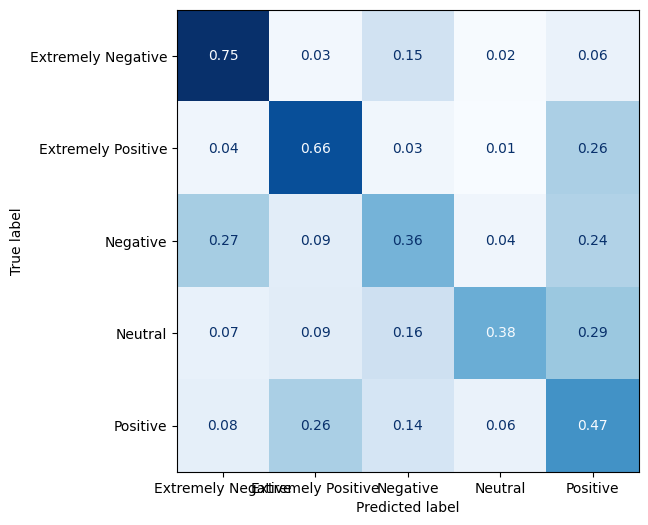

In [167]:
#| label: code-14
metricas(Y_test, y_pred_MNB)

The model is giving random results for each of the metrics and is not giving great results

Now it will be checked how this model performs with the pool of datasets that has been built

In [96]:
from sklearn import metrics, linear_model, tree, discriminant_analysis, ensemble, neural_network, inspection

for data in list(datasets.keys())[:9]:
    fitted_model = MultinomialNB().fit(datasets[data]['train'], Y_train)
    y_train_pred = fitted_model.predict(datasets[data]['train'])
    y_test_pred = fitted_model.predict(datasets[data]['test'])
    datasets[data]['Accuracy_train'] = metrics.accuracy_score(Y_train, y_train_pred)
    datasets[data]['Accuracy_test'] = metrics.accuracy_score(Y_test, y_test_pred)
    datasets[data]['F1_test'] = metrics.f1_score(Y_test, y_test_pred, average='weighted')

In [97]:
#| label: code-15
class_metrics = pd.DataFrame.\
    from_dict(datasets, 'index')[['Accuracy_train', 'Accuracy_test',
                                      'F1_test']]
class_metrics.sort_values(by='Accuracy_test', ascending=False)   

,Accuracy_train,Accuracy_test,F1_test
tf-idf case 2,0.789268,0.615807,0.613486
tf-idf case 3,0.766334,0.614393,0.612125
tf-idf case 4,0.738159,0.614309,0.611962
N-grams case 1,0.979673,0.540516,0.520580
Bag of words case 2,0.722213,0.520133,0.516547
Bag of words case 3,0.670438,0.520133,0.514778
Bag of words case 1,0.737299,0.517720,0.511114
Bag of words case 4,0.619773,0.510483,0.504621
N-grams case 2,0.706406,0.509484,0.504226
N-grams case 3,0.698641,0.506156,0.500874


It can be seen that in all the cases there is an overfitting since the difference between the train and  test is of abour 20%

## 3.3 Logistic regression

In [89]:
# Logistic regression
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression() #class_weight="balanced")
logreg.fit(x_train_bow_testa,Y_train) 
y_pred_lr = logreg.predict(x_test_bow_testa)

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Result of the logistic regression

Accuracy:  0.6539933444259567
              precision    recall  f1-score   support

           0       0.77      0.74      0.76      2236
           1       0.76      0.71      0.74      2280
           2       0.54      0.53      0.54      2479
           3       0.67      0.74      0.70      2169
           4       0.57      0.58      0.57      2856

    accuracy                           0.65     12020
   macro avg       0.66      0.66      0.66     12020
weighted avg       0.66      0.65      0.65     12020



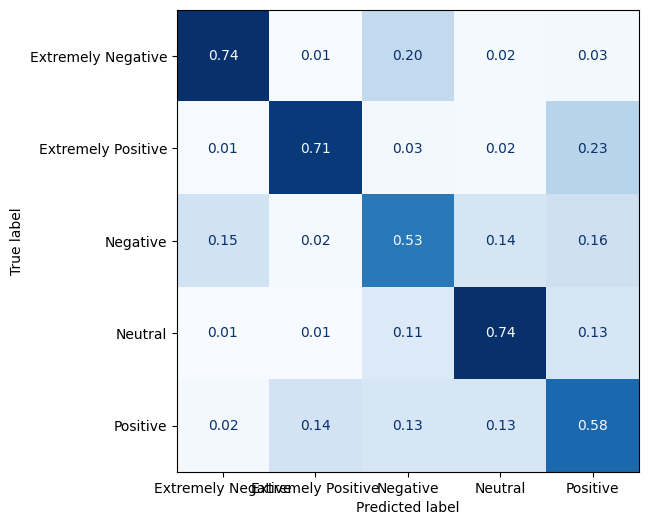

In [155]:
#| label: code-16
metricas(Y_test, y_pred_lr)

The Logistic Regression is a better classifier. Now the accuracy is of about 63%

In [94]:
for data in list(datasets.keys()):
    fitted_model = LogisticRegression().fit(datasets[data]['train'], Y_train)
    y_train_pred = fitted_model.predict(datasets[data]['train'])
    y_test_pred = fitted_model.predict(datasets[data]['test'])
    datasets[data]['Accuracy_train'] = metrics.accuracy_score(Y_train, y_train_pred)
    datasets[data]['Accuracy_test'] = metrics.accuracy_score(Y_test, y_test_pred)
    datasets[data]['F1_test'] = metrics.f1_score(Y_test, y_test_pred, average='weighted')

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_

In [95]:
#| label: code-17
class_metrics = pd.DataFrame.\
    from_dict(datasets, 'index')[['Accuracy_train', 'Accuracy_test',
                                      'F1_test']]
class_metrics.sort_values(by='Accuracy_test', ascending=False)   

,Accuracy_train,Accuracy_test,F1_test
Bag of words case 1,0.890266,0.655491,0.654289
Bag of words case 2,0.877787,0.653744,0.652258
N-grams case 1,0.999750,0.653744,0.649574
Bag of words case 3,0.844010,0.649334,0.648297
Bag of words case 4,0.805103,0.648087,0.647560
N-grams case 2,0.971908,0.630200,0.629032
N-grams case 3,0.968996,0.628619,0.627243
N-grams case 4,0.969717,0.627205,0.626754
tf-idf case 2,0.789268,0.615807,0.613486
tf-idf case 3,0.766334,0.614393,0.612125


In [162]:
#trying with the pretrained embedding

X_train_embed_w2v_tweeter[np.isnan(X_train_embed_w2v_tweeter)] = 0.001
X_test_embed_w2v_tweeter[np.isnan(X_test_embed_w2v_tweeter)] = 0.001

logreg_w2v = LogisticRegression()
%time logreg_w2v.fit(X_train_embed_w2v_tweeter,Y_train)
y_pred_lr_w2v = logreg_w2v.predict(X_test_embed_w2v_tweeter)


CPU times: total: 1.42 s
Wall time: 1.97 s


c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy:  0.43885191347753744
              precision    recall  f1-score   support

           0       0.50      0.57      0.53      2236
           1       0.53      0.55      0.54      2280
           2       0.35      0.28      0.31      2479
           3       0.47      0.44      0.45      2169
           4       0.35      0.39      0.37      2856

    accuracy                           0.44     12020
   macro avg       0.44      0.44      0.44     12020
weighted avg       0.44      0.44      0.44     12020



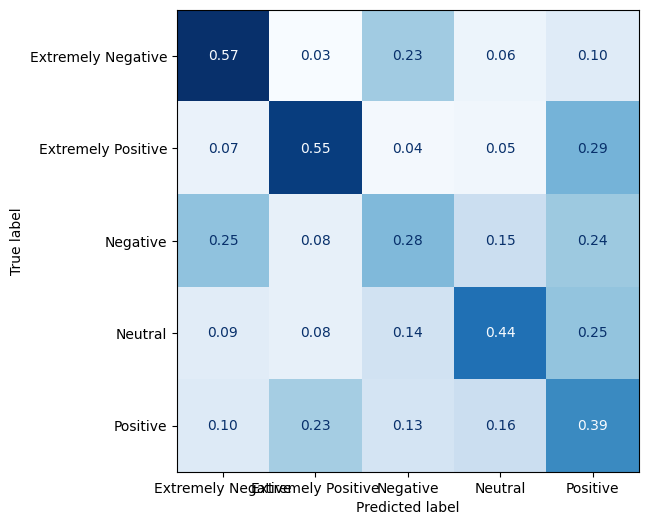

In [163]:
#| label: code-18
metricas(Y_test, y_pred_lr_w2v)

In [159]:
from sklearn.svm import LinearSVC

classifier = LinearSVC()#(class_weight='balanced') # instantiate a logistic regression model
classifier.fit(x_train_bow_testa, Y_train) # fit the model with training data

# Make predictions on test data
y_pred_svc = classifier.predict(x_test_bow_testa)

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Accuracy:  0.6032445923460898
              precision    recall  f1-score   support

           0       0.75      0.79      0.77      2236
           1       0.70      0.75      0.72      2280
           2       0.48      0.41      0.44      2479
           3       0.59      0.69      0.63      2169
           4       0.49      0.44      0.46      2856

    accuracy                           0.60     12020
   macro avg       0.60      0.62      0.61     12020
weighted avg       0.59      0.60      0.60     12020



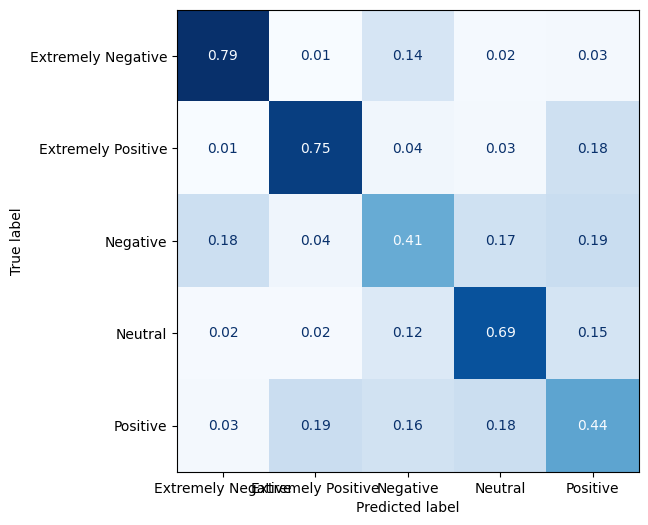

In [160]:
#| label: code-19
metricas(Y_test, y_pred_svc)

The SVC also is a better model than Bayesian Gaussian. However, it is not the best option

In [98]:
for data in list(datasets.keys()):
    fitted_model = LinearSVC().fit(datasets[data]['train'], Y_train)
    y_train_pred = fitted_model.predict(datasets[data]['train'])
    y_test_pred = fitted_model.predict(datasets[data]['test'])
    datasets[data]['Accuracy_train'] = metrics.accuracy_score(Y_train, y_train_pred)
    datasets[data]['Accuracy_test'] = metrics.accuracy_score(Y_test, y_test_pred)
    datasets[data]['F1_test'] = metrics.f1_score(Y_test, y_test_pred, average='weighted')

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` expl

In [99]:
#| label: code-20
class_metrics = pd.DataFrame.\
    from_dict(datasets, 'index')[['Accuracy_train', 'Accuracy_test',
                                      'F1_test']]
class_metrics.sort_values(by='Accuracy_test', ascending=False) 

,Accuracy_train,Accuracy_test,F1_test
N-grams case 1,0.999889,0.634359,0.626083
tf-idf case 1,0.925430,0.617554,0.607794
tf-idf case 2,0.905935,0.615724,0.606290
tf-idf case 4,0.781864,0.612978,0.602221
tf-idf case 3,0.848918,0.609734,0.600272
Bag of words case 4,0.815585,0.605990,0.596530
Bag of words case 2,0.965530,0.605574,0.599426
Bag of words case 1,0.976095,0.603161,0.596607
Bag of words case 3,0.912230,0.602912,0.595109
N-grams case 2,0.998447,0.569634,0.567153


Random Forest

In [100]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier

classifier = RandomForestClassifier()#(class_weight='balanced') # instantiate a logistic regression model
classifier.fit(x_train_bow_testa, Y_train) # fit the model with training data

# Make predictions on test data
y_pred_rfc = classifier.predict(x_test_bow_testa)

Accuracy:  0.6085690515806988
              precision    recall  f1-score   support

           0       0.75      0.77      0.76      2236
           1       0.74      0.66      0.70      2280
           2       0.53      0.38      0.44      2479
           3       0.58      0.75      0.65      2169
           4       0.49      0.52      0.51      2856

    accuracy                           0.61     12020
   macro avg       0.62      0.62      0.61     12020
weighted avg       0.61      0.61      0.60     12020



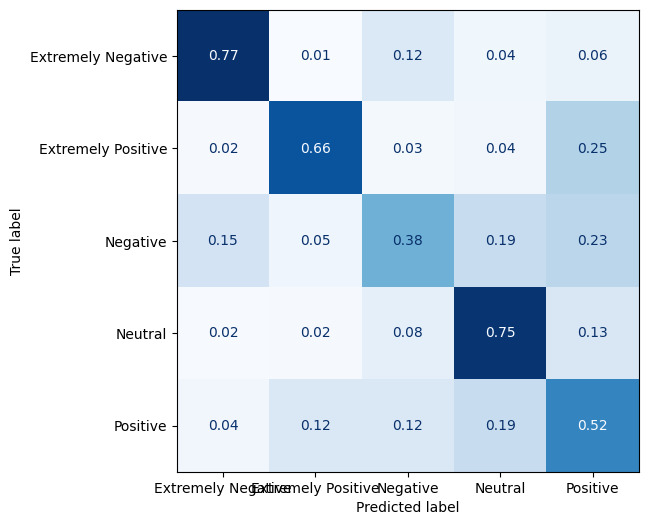

In [103]:
#| label: code-21
metricas(Y_test, y_pred_rfc)

In [111]:
'''for data in list(datasets.keys()):
    fitted_model = RandomForestClassifier().fit(datasets[data]['train'], Y_train)
    y_train_pred = fitted_model.predict(datasets[data]['train'])
    y_test_pred = fitted_model.predict(datasets[data]['test'])
    datasets[data]['Accuracy_train'] = metrics.accuracy_score(Y_train, y_train_pred)
    datasets[data]['Accuracy_test'] = metrics.accuracy_score(Y_test, y_test_pred)
    datasets[data]['F1_test'] = metrics.f1_score(Y_test, y_test_pred, average='weighted')'''

"for data in list(datasets.keys()):\n    fitted_model = RandomForestClassifier().fit(datasets[data]['train'], Y_train)\n    y_train_pred = fitted_model.predict(datasets[data]['train'])\n    y_test_pred = fitted_model.predict(datasets[data]['test'])\n    datasets[data]['Accuracy_train'] = metrics.accuracy_score(Y_train, y_train_pred)\n    datasets[data]['Accuracy_test'] = metrics.accuracy_score(Y_test, y_test_pred)\n    datasets[data]['F1_test'] = metrics.f1_score(Y_test, y_test_pred, average='weighted')"

Gradient Boosting Classifier

In [105]:

classifier = GradientBoostingClassifier()#(class_weight='balanced') # instantiate a logistic regression model
classifier.fit(x_train_bow_testa, Y_train) # fit the model with training data

# Make predictions on test data
y_pred_gbc = classifier.predict(x_test_bow_testa)

Accuracy:  0.5054908485856905
              precision    recall  f1-score   support

           0       0.65      0.57      0.61      2236
           1       0.67      0.57      0.62      2280
           2       0.47      0.29      0.36      2479
           3       0.49      0.62      0.55      2169
           4       0.37      0.50      0.43      2856

    accuracy                           0.51     12020
   macro avg       0.53      0.51      0.51     12020
weighted avg       0.52      0.51      0.50     12020



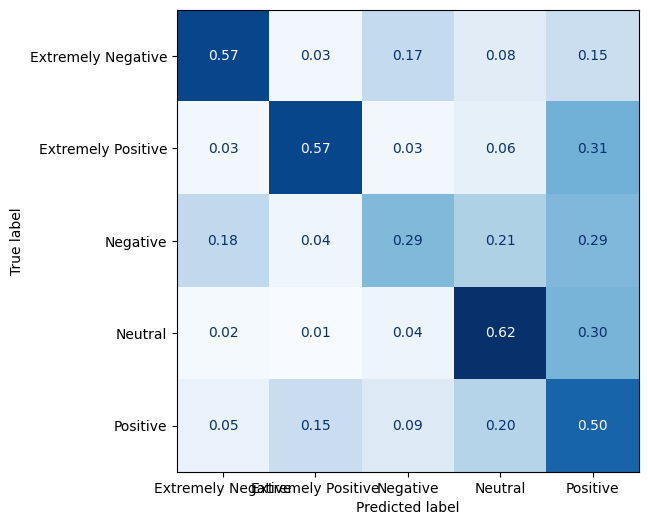

In [106]:
metricas(Y_test, y_pred_gbc)

In [ ]:
'''for data in list(datasets.keys()):
    fitted_model = GradientBoostingClassifier().fit(datasets[data]['train'], Y_train)
    y_train_pred = fitted_model.predict(datasets[data]['train'])
    y_test_pred = fitted_model.predict(datasets[data]['test'])
    datasets[data]['Accuracy_train'] = metrics.accuracy_score(Y_train, y_train_pred)
    datasets[data]['Accuracy_test'] = metrics.accuracy_score(Y_test, y_test_pred)
    datasets[data]['F1_test'] = metrics.f1_score(Y_test, y_test_pred, average='weighted')'''

SGDClassifier

In [107]:
from sklearn.linear_model import SGDClassifier

classifier = SGDClassifier()
classifier.fit(x_train_bow_testa, Y_train) # fit the model with training data

# Make predictions on test data
y_pred_sgd = classifier.predict(x_test_bow_testa)

Accuracy:  0.6247088186356073
              precision    recall  f1-score   support

           0       0.69      0.86      0.76      2236
           1       0.70      0.80      0.75      2280
           2       0.53      0.40      0.45      2479
           3       0.60      0.78      0.68      2169
           4       0.56      0.39      0.46      2856

    accuracy                           0.62     12020
   macro avg       0.62      0.64      0.62     12020
weighted avg       0.61      0.62      0.61     12020



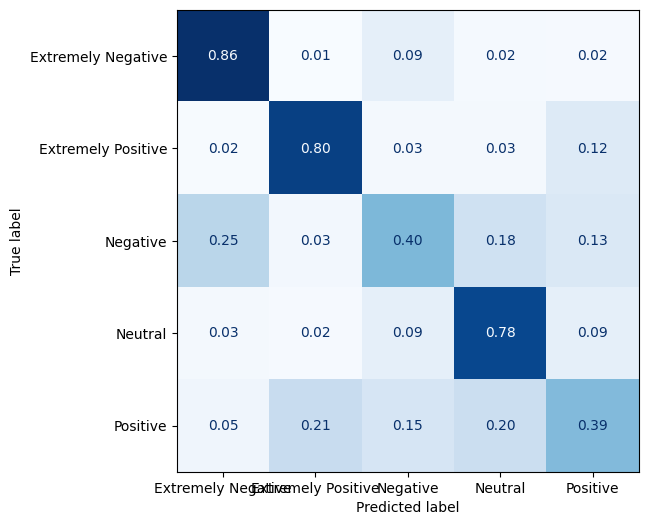

In [108]:
#| label: code-22
metricas(Y_test, y_pred_sgd)

In [ ]:
for data in list(datasets.keys()):
    fitted_model = SGDClassifier().fit(datasets[data]['train'], Y_train)
    y_train_pred = fitted_model.predict(datasets[data]['train'])
    y_test_pred = fitted_model.predict(datasets[data]['test'])
    datasets[data]['Accuracy_train'] = metrics.accuracy_score(Y_train, y_train_pred)
    datasets[data]['Accuracy_test'] = metrics.accuracy_score(Y_test, y_test_pred)
    datasets[data]['F1_test'] = metrics.f1_score(Y_test, y_test_pred, average='weighted')

From the previous exercises,several model has been tested. Neither of them have a outstading performance. However, the best models that we are going to choose are:
+ Logistic Regression -65%
+ Linear SVC - 60%
+ SGDClassifiers - 62 %

In matters of the ideal dataset it will be  choose the tf-tfit case 4 since:
+ even though don't provides the best accuracy of all the datasets it is the one that presents less overfitting when comparing training and testing
+ the dataset does perform still good with around 60 % of accuracy
+ the Multinomial Bayes is the model with most overfitting and less accuracy. This models is going to be excluded

*It will also be considered Glove-twitter embedding -100 even thought has the worst performance is the only dataset with no case of overfittig. Adjustments on the hyperparameter can increase the performance of the model*

Ensemble method modeling

# Hyperparametrization

Logistic Regression

In [142]:
from sklearn.model_selection import GridSearchCV
lr_impr = LogisticRegression()

parameters = {
    'penalty': [None,'l1', 'l2'],  
    'C': [100, 10, 1.0, 0.1, 0.01],
    'class_weight': [None,'balanced'],
    'solver':['lbfgs','newton-cg', 'sag'] 
}

gcv_lr = GridSearchCV(lr_impr, parameters, n_jobs=-1)
gcv_lr.fit(datasets['tf-idf case 2']['train'], Y_train)

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning: 
150 fits failed out of a total of 450.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
50 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py", line 1172, in fit
    solver =

GridSearchCV(estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [100, 10, 1.0, 0.1, 0.01],
                         'class_weight': [None, 'balanced'],
                         'penalty': [None, 'l1', 'l2'],
                         'solver': ['lbfgs', 'newton-cg', 'sag']})

In [143]:
#| label: code-23
print("Best parameters:", gcv_lr.best_params_)
best_model_lr = gcv_lr.best_estimator_
y_val_gcv_lr = best_model_lr.predict(datasets['tf-idf case 2']['test'])

Best parameters: {'C': 10, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'sag'}


Accuracy:  0.6417637271214642
              precision    recall  f1-score   support

           0       0.74      0.78      0.76      2236
           1       0.71      0.74      0.72      2280
           2       0.56      0.51      0.53      2479
           3       0.64      0.73      0.68      2169
           4       0.57      0.50      0.53      2856

    accuracy                           0.64     12020
   macro avg       0.64      0.65      0.65     12020
weighted avg       0.64      0.64      0.64     12020



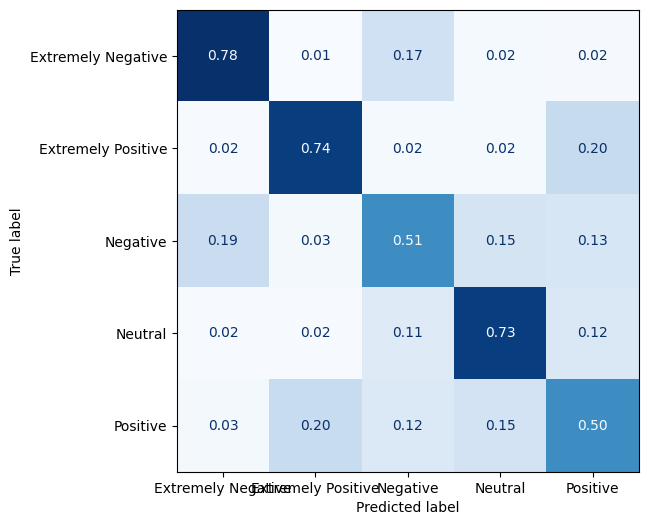

In [125]:
#| label: code-24
metricas(Y_test, y_val_gcv_lr)

In this case, the dataset related to the pre-trained embedding is not improving. For time limits it is going to be drop this option an maintain the tf-idf vectoring

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning: 
150 fits failed out of a total of 450.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
50 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py", line 1172, in fit
    solver =

Accuracy:  0.4324459234608985
              precision    recall  f1-score   support

           0       0.50      0.56      0.53      2236
           1       0.53      0.54      0.54      2280
           2       0.33      0.27      0.30      2479
           3       0.47      0.44      0.45      2169
           4       0.34      0.38      0.36      2856

    accuracy                           0.43     12020
   macro avg       0.44      0.44      0.44     12020
weighted avg       0.43      0.43      0.43     12020



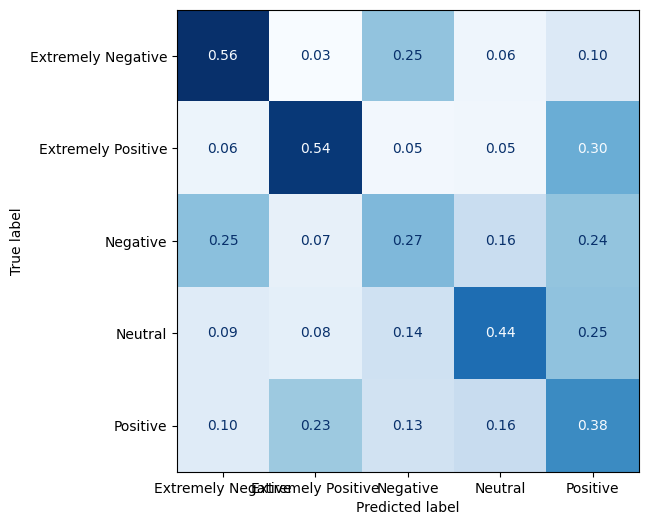

In [126]:
from sklearn.model_selection import GridSearchCV
lr_impr = LogisticRegression()

parameters = {
    'penalty': [None,'l1', 'l2'],  
    'C': [100, 10, 1.0, 0.1, 0.01],
    'class_weight': [None,'balanced'],
    'solver':['lbfgs','newton-cg', 'sag'] 
}

gcv_lr = GridSearchCV(lr_impr, parameters, n_jobs=-1)
gcv_lr.fit(datasets['w2v embedding']['train'], Y_train)

best_model_lr_w2v = gcv_lr.best_estimator_
y_val_gcv_lr_w2v = best_model_lr_w2v.predict(datasets['w2v embedding']['test'])
metricas(Y_test, y_val_gcv_lr_w2v)

Linear SVC

For topics of time this model is not analyzed with the hyperparametrization

In [133]:
'''classifier = LinearSVC()

parameters = {
    'penalty': [None, 'l1', 'l2'],
    'tol': [1e-3, 1e-4, 1e-5],
    'C': [0.1, 1.0, 10, 100],
    'multi_class': ['ovr', 'crammer_singer'],
    'loss': ['hinge', 'squared_hinge'],
    'random_state': [42]
}

gcv_svc = GridSearchCV(classifier, parameters, n_jobs=-1)

X_train = datasets['tf-idf case 2']['train']
gcv_svc.fit(X_train, Y_train) 

best_model_svc = gcv_svc.best_estimator_
y_val_gcv_svc= best_model_svc.predict(datasets['tf-idf case 2']['test'])
metricas(Y_test, y_val_gcv_svc)
'''

"classifier = LinearSVC()\n\nparameters = {\n    'penalty': [None, 'l1', 'l2'],\n    'tol': [1e-3, 1e-4, 1e-5],\n    'C': [0.1, 1.0, 10, 100],\n    'multi_class': ['ovr', 'crammer_singer'],\n    'loss': ['hinge', 'squared_hinge'],\n    'random_state': [42]\n}\n\ngcv_svc = GridSearchCV(classifier, parameters, n_jobs=-1)\n\nX_train = datasets['tf-idf case 2']['train']\ngcv_svc.fit(X_train, Y_train) \n\nbest_model_svc = gcv_svc.best_estimator_\ny_val_gcv_svc= best_model_svc.predict(datasets['tf-idf case 2']['test'])\nmetricas(Y_test, y_val_gcv_svc)\n"

SGD Classifiers


c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:723: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


Accuracy:  0.5595673876871881
              precision    recall  f1-score   support

           0       0.60      0.83      0.69      2236
           1       0.58      0.82      0.68      2280
           2       0.49      0.26      0.33      2479
           3       0.57      0.71      0.63      2169
           4       0.50      0.29      0.36      2856

    accuracy                           0.56     12020
   macro avg       0.55      0.58      0.54     12020
weighted avg       0.54      0.56      0.53     12020



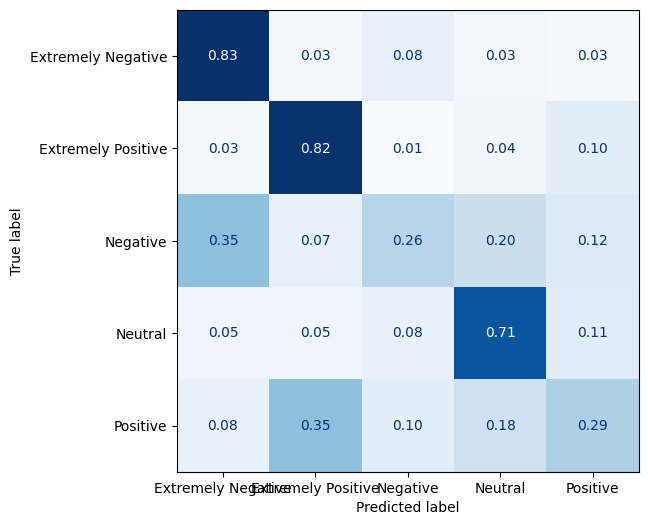

In [138]:
#| label: code-25
classifier = SGDClassifier()

parameters = {
    'alpha': [0.001, 0.1, 1.0],
    'penalty': [None, 'l1', 'l2'],
    'tol': [ 1e-4, 1e-5],
    'max_iter': [100, 500],
    #'multi_class': ['ovr', 'multinomial'],
    #'loss': ['hinge', 'log'],
    'random_state': [42]
}

gcv_sgd = GridSearchCV(classifier, parameters, n_jobs=-1)

X_train_win = datasets['tf-idf case 2']['train']
gcv_sgd.fit(X_train, Y_train) 

best_model_sgd = gcv_sgd.best_estimator_
y_val_gcv_sgd= best_model_sgd.predict(datasets['tf-idf case 2']['test'])
metricas(Y_test, y_val_gcv_sgd)

Finally we will try with Stacking 

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:723: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_clas

Accuracy:  0.6792013311148086
              precision    recall  f1-score   support

           0       0.76      0.81      0.78      2236
           1       0.74      0.78      0.76      2280
           2       0.62      0.53      0.57      2479
           3       0.69      0.75      0.71      2169
           4       0.60      0.58      0.59      2856

    accuracy                           0.68     12020
   macro avg       0.68      0.69      0.68     12020
weighted avg       0.67      0.68      0.68     12020



c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


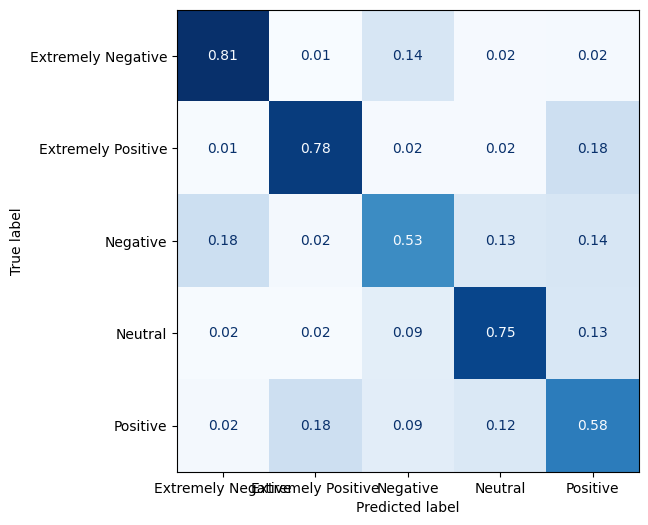

In [144]:
from sklearn.ensemble import StackingClassifier
estimators = [('lr',best_model_lr),
              ('svc',LinearSVC()),
              ('sgd',best_model_sgd)]
stacking_clf = StackingClassifier(estimators=estimators, final_estimator=LinearSVC())
stacking_clf.fit(X_train_win, Y_train)


y_val_stacking_clf = stacking_clf.predict(datasets['tf-idf case 2']['test'])
metricas(Y_test, y_val_stacking_clf)

It is making a little change to apply the interpretability part

c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:723: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeanl\anaconda3\Lib\site-packages\sklearn\svm\_clas

Accuracy:  0.7083194675540765
              precision    recall  f1-score   support

           0       0.79      0.83      0.81      2236
           1       0.75      0.82      0.78      2280
           2       0.63      0.59      0.61      2479
           3       0.73      0.76      0.74      2169
           4       0.65      0.59      0.62      2856

    accuracy                           0.71     12020
   macro avg       0.71      0.72      0.71     12020
weighted avg       0.70      0.71      0.71     12020



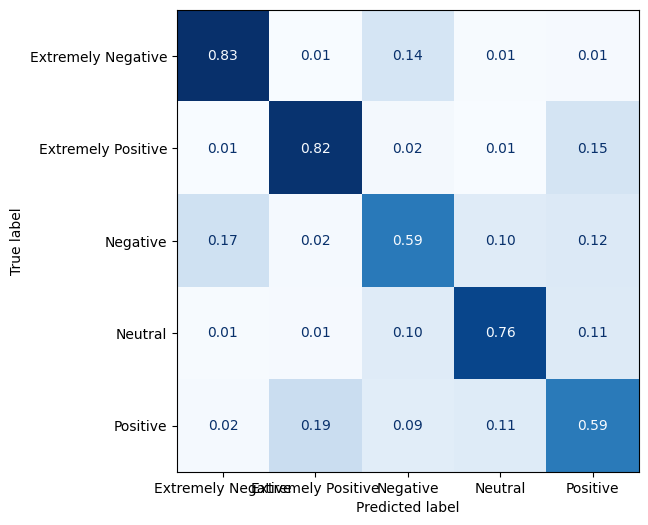

In [247]:
#| label: code-26
from sklearn.ensemble import StackingClassifier
X_train_win = datasets['tf-idf case 2']['train']
estimators = [('lr',best_model_lr),
              ('svc',LinearSVC()),
              ('sgd',best_model_sgd)]
stacking_clf = StackingClassifier(estimators=estimators, final_estimator=best_model_lr)
stacking_clf.fit(X_train_win, Y_train)


y_val_stacking_clf = stacking_clf.predict(datasets['tf-idf case 2']['test'])
metricas(Y_test, y_val_stacking_clf)

# 8. Check on Validation set 

Accuracy:  0.6492890995260664
              precision    recall  f1-score   support

           0       0.65      0.76      0.70       592
           1       0.70      0.75      0.72       599
           2       0.64      0.54      0.58      1041
           3       0.67      0.74      0.70       619
           4       0.61      0.58      0.60       947

    accuracy                           0.65      3798
   macro avg       0.65      0.67      0.66      3798
weighted avg       0.65      0.65      0.65      3798



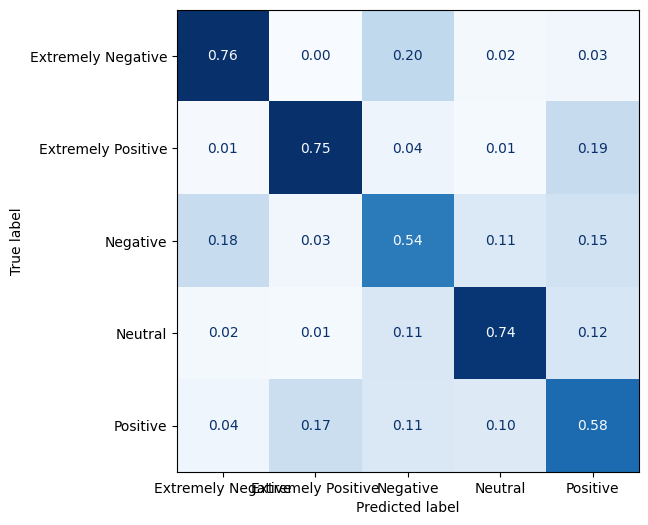

In [248]:
#| label: code-27
#Pipeline to treat the set


valid_df = pd.read_csv(r'D:\Documents\Documents\EM Lyon\001B_Semester_2\02-Natural language processing\Final exam\TP Exam\Corona_NLP_test.csv', encoding='latin')
valid_df = valid_df[['OriginalTweet', 'Sentiment']]


le = LabelEncoder()
valid_df['Sentiment'] = le.fit_transform(valid_df['Sentiment'])

Y_valid = valid_df['Sentiment']
X_valid = valid_df['OriginalTweet']
X_valid = X_valid.apply(strip)

#tf_dif_val = TfidfVectorizer(max_features = 25000)
X_valid_fin = tfidif_testb.transform(X_valid)

X_valid_fin.shape

y_valid_pred = stacking_clf.predict(X_valid_fin)
metricas(Y_valid, y_valid_pred)


# 9. Interpretability

In [230]:
#!pip install lime shap

In [253]:
le.classes_

array(['Extremely Negative', 'Extremely Positive', 'Negative', 'Neutral',
       'Positive'], dtype=object)

In [254]:
import lime
from lime.lime_text import LimeTextExplainer
from sklearn.pipeline import make_pipeline

log_reg_pipeline = make_pipeline(tfidif_testb, stacking_clf)
lime_explainer = LimeTextExplainer(class_names=['Extremely Negative', 'Extremely Positive', 'Negative', 'Neutral',
       'Positive'])

In [257]:
#| label: code-28
idx =10
text_instance = X_valid.iloc[idx]
text_instance

'best quality couch at unbelievably low price available to order we are in boksburg gp for more info whatsapp 084 764 8086 supertuesdsy powertalk covid 19 sayentrepreneur djsbu'

**Interpretation:**
+ The code interprets the *tweet 10* as Positive with a confidence of 58%. being the next strong class the *Extremely positive* tag with 29 % 

+ the words *best* and *quality* are words that propose that the tweet is **extremely positive**
+ however, the more words related not related to it drag the probabily down.

In [258]:
#| label: code-29
lime_explainer.explain_instance(text_instance,
                                    log_reg_pipeline.predict_proba, num_features=6).show_in_notebook(text=True)